[参考](https://qiita.com/nymwa/items/4542b45837a10766890b)  
言語処理100本ノック 2020 第9章: RNN, CNN   
@nymwa

In [1]:
!pip install optuna tensorflow-gpu transformers

     |████████████████████████████████| 163kB 9.1MB/s 
     |████████████████████████████████| 421.8MB 37kB/s 
     |████████████████████████████████| 573kB 48.5MB/s 
     |████████████████████████████████| 1.1MB 63.9MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 81kB 12.9MB/s 
     |████████████████████████████████| 3.9MB 52.2MB/s 
     |████████████████████████████████| 450kB 42.1MB/s 
     |████████████████████████████████| 890kB 45.8MB/s 
     |████████████████████████████████| 1.0MB 41.0MB/s 
     |████████████████████████████████| 3.7MB 54.2MB/s 
     |████████████████████████████████| 81kB 13.3MB/s 
     |████████████████████████████████| 61kB 10.5MB/s 
     |████████████████████████████████| 112kB 59.9MB/s 
     |████████████████████████████████| 51kB 10.4MB/s 
  Created wheel for alembic: filename=alembic-1.4.2-cp36-none-any.whl size=159543 sha256=b41a39

In [2]:
import tensorflow as tf
tf.test.gpu_device_name()

'/device:GPU:0'

In [0]:
import re
import spacy
import tensorflow as tf
from collections import Counter
import matplotlib.pyplot as plt
import numpy as np
import optuna

# 80

In [0]:
nlp = spacy.load('en')
categories = ['b', 't', 'e', 'm']
category_names = ['business', 'science and technology', 'entertainment', 'health']

In [0]:
def tokenize(x):
    x = re.sub(r'\s+', ' ', x)
    x = nlp.make_doc(x)
    x = [d.text for d in x]
    return x

def read_feature_dataset(filename):
    with open(filename) as f:
        dataset = f.read().splitlines()
    dataset = [line.split('\t') for line in dataset]
    t_index = [categories.index(line[0]) for line in dataset]
    dataset_t = []
    for index in t_index:
        label = [0]*4
        label[index] = 1
        dataset_t.append(label)
    dataset_x = [tokenize(line[1]) for line in dataset]
    return dataset_x, dataset_t

In [6]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
train_x, train_t = read_feature_dataset('/content/drive/My Drive/Colab/NLP100/data/train.txt')
valid_x, valid_t = read_feature_dataset('/content/drive/My Drive/Colab/NLP100/data/valid.txt')
test_x, test_t = read_feature_dataset('/content/drive/My Drive/Colab/NLP100/data/test.txt')

In [8]:
counter = Counter([
    x
    for sent in train_x
    for x in sent
])

vocab_in_train = [
    token
    for token, freq in counter.most_common()
    if freq > 1
]
len(vocab_in_train)

9700

In [9]:
vocab_in_train

['-',
 "'",
 'to',
 ',',
 '...',
 "'s",
 'in',
 'on',
 'UPDATE',
 ':',
 'as',
 'of',
 'for',
 'The',
 'US',
 'To',
 'the',
 'and',
 '$',
 '"',
 'In',
 'Of',
 'at',
 'a',
 '(',
 ')',
 'With',
 'Is',
 'For',
 'A',
 'And',
 'with',
 'after',
 'New',
 '?',
 'Kardashian',
 ';',
 'On',
 'China',
 'up',
 'by',
 'Kim',
 'After',
 'says',
 '1',
 'At',
 'is',
 'STOCKS',
 '!',
 'Fed',
 'From',
 'new',
 "n't",
 'ECB',
 '2',
 'from',
 'her',
 'Wall',
 'It',
 'shares',
 'Says',
 'FOREX',
 'data',
 'First',
 'About',
 'Miley',
 'Cyrus',
 'Euro',
 'CEO',
 'over',
 'West',
 'Dollar',
 'You',
 'St',
 'she',
 'May',
 'bln',
 'Chris',
 'Over',
 'Ukraine',
 'Will',
 'Stocks',
 'More',
 'Kanye',
 'As',
 'Be',
 'Up',
 'Are',
 'Google',
 'be',
 '.',
 'Justin',
 'Bieber',
 'off',
 'Billion',
 'I',
 'Star',
 'profit',
 'euro',
 '2014',
 'GLOBAL',
 'Bank',
 'are',
 'Time',
 'out',
 'RPT',
 'but',
 'Not',
 'How',
 'sales',
 'deal',
 'it',
 'more',
 'That',
 'UK',
 'that',
 'Day',
 'Gold',
 'pct',
 'What',
 'Apple

In [0]:
vocab_list = ['[UNK]'] + vocab_in_train
vocab_dict = {x:n for n, x in enumerate(vocab_list)}

In [11]:
vocab_dict

{'[UNK]': 0,
 '-': 1,
 "'": 2,
 'to': 3,
 ',': 4,
 '...': 5,
 "'s": 6,
 'in': 7,
 'on': 8,
 'UPDATE': 9,
 ':': 10,
 'as': 11,
 'of': 12,
 'for': 13,
 'The': 14,
 'US': 15,
 'To': 16,
 'the': 17,
 'and': 18,
 '$': 19,
 '"': 20,
 'In': 21,
 'Of': 22,
 'at': 23,
 'a': 24,
 '(': 25,
 ')': 26,
 'With': 27,
 'Is': 28,
 'For': 29,
 'A': 30,
 'And': 31,
 'with': 32,
 'after': 33,
 'New': 34,
 '?': 35,
 'Kardashian': 36,
 ';': 37,
 'On': 38,
 'China': 39,
 'up': 40,
 'by': 41,
 'Kim': 42,
 'After': 43,
 'says': 44,
 '1': 45,
 'At': 46,
 'is': 47,
 'STOCKS': 48,
 '!': 49,
 'Fed': 50,
 'From': 51,
 'new': 52,
 "n't": 53,
 'ECB': 54,
 '2': 55,
 'from': 56,
 'her': 57,
 'Wall': 58,
 'It': 59,
 'shares': 60,
 'Says': 61,
 'FOREX': 62,
 'data': 63,
 'First': 64,
 'About': 65,
 'Miley': 66,
 'Cyrus': 67,
 'Euro': 68,
 'CEO': 69,
 'over': 70,
 'West': 71,
 'Dollar': 72,
 'You': 73,
 'St': 74,
 'she': 75,
 'May': 76,
 'bln': 77,
 'Chris': 78,
 'Over': 79,
 'Ukraine': 80,
 'Will': 81,
 'Stocks': 82,
 'Mo

In [0]:
def sent_to_ids(sent):
    return tf.constant([vocab_dict[x if x in vocab_dict else '[UNK]'] for x in sent], dtype=tf.int64)

In [13]:
print(train_x[0])
print(sent_to_ids(train_x[0]).numpy())

['White', 'House', 'Science', 'Fair', 'Will', 'Focus', 'On', 'Girls', 'In', 'STEM']
[ 482  454 3026 1563   81 2095   38  941   21    0]


In [0]:
def dataset_to_ids(dataset):
    return [sent_to_ids(x) for x in dataset]

In [0]:
train_s = dataset_to_ids(train_x)
valid_s = dataset_to_ids(valid_x)
test_s = dataset_to_ids(test_x)

# 81

In [16]:
max_len = 0
for x in train_s:
    if x.shape[0] > max_len:
        max_len = x.shape[0]
for x in valid_s:
    if x.shape[0] > max_len:
        max_len = x.shape[0]
max_len

25

In [0]:
def padding_zero(data, max_len):
    ret = []
    for i in range(len(data)):
        zero = [0] * (max_len - data[i].shape[0])
        ret.append(tf.concat([data[i], zero], 0))
    return tf.stack(ret)

In [0]:
train_s = padding_zero(train_s, max_len)
train_t = tf.stack(train_t)
valid_s = padding_zero(valid_s, max_len)
valid_t = tf.stack(valid_t)
test_s = padding_zero(test_s, max_len)
test_t = tf.stack(test_t)

In [19]:
train_s.shape

TensorShape([10684, 25])

In [20]:
train_t.shape

TensorShape([10684, 4])

In [0]:
def loss(t, y):
    return tf.keras.backend.mean(tf.keras.losses.categorical_crossentropy(t,y))
def acc(t,y):
    return tf.keras.backend.mean(tf.keras.metrics.categorical_accuracy(t,y))

In [0]:
class RNN81(tf.keras.Model):
    def __init__(self, v_size, e_size, h_size, c_size, dropout=0.2):
        super().__init__()
        self.emb = tf.keras.layers.Embedding(
            input_dim=v_size, 
            output_dim=e_size,
            mask_zero=True
        )
        self.rnn = tf.keras.layers.LSTM(
            h_size
        )
        self.out = tf.keras.layers.Dense(
            c_size
        )

    def call(self, x):
        x = self.emb(x)
        x = self.rnn(x)
        y = tf.nn.softmax(self.out(x))
        return y

In [0]:
model = RNN81(len(vocab_dict), 300, 50, 4)
model.compile(optimizer=tf.keras.optimizers.SGD(learning_rate=0.1),
              loss=loss,
              metrics=['accuracy']
             )
model.build(train_s.shape)
model.summary()

Model: "rn_n81"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        multiple                  2910300   
_________________________________________________________________
lstm (LSTM)                  multiple                  70200     
_________________________________________________________________
dense (Dense)                multiple                  204       
Total params: 2,980,704
Trainable params: 2,980,704
Non-trainable params: 0
_________________________________________________________________


In [0]:
y = model(test_s)
t = test_t
acc(t, y).numpy()

0.25

# 82

In [0]:
!rm -r '/content/drive/My Drive/Colab/NLP100/log/82'

In [0]:
tb_cb = tf.keras.callbacks.TensorBoard(
    log_dir='/content/drive/My Drive/Colab/NLP100/log/82',
    histogram_freq=1,
    write_images=True
)

In [0]:
%reload_ext tensorboard
%tensorboard --logdir '/content/drive/My Drive/Colab/NLP100/log/82' --bind_all --reload_multifile true

Output hidden; open in https://colab.research.google.com to view.

In [0]:
history = model.fit(train_s,train_t,
                    epochs=10, 
                    validation_data=(valid_s, valid_t),
                    verbose=1,
                    callbacks=[tb_cb]
                   )

Train on 10684 samples, validate on 1336 samples
Epoch 1/10
10684/10684 [==============================] - 21s 2ms/sample - loss: 1.1077 - accuracy: 0.5459 - val_loss: 0.9844 - val_accuracy: 0.5958
Epoch 2/10
10684/10684 [==============================] - 17s 2ms/sample - loss: 0.8547 - accuracy: 0.7023 - val_loss: 0.8258 - val_accuracy: 0.6991
Epoch 3/10
10684/10684 [==============================] - 16s 1ms/sample - loss: 0.6914 - accuracy: 0.7604 - val_loss: 0.6214 - val_accuracy: 0.7762
Epoch 4/10
10684/10684 [==============================] - 16s 2ms/sample - loss: 0.5743 - accuracy: 0.7879 - val_loss: 0.5435 - val_accuracy: 0.7904
Epoch 5/10
10684/10684 [==============================] - 16s 2ms/sample - loss: 0.4771 - accuracy: 0.8132 - val_loss: 0.4913 - val_accuracy: 0.8009
Epoch 6/10
10684/10684 [==============================] - 16s 2ms/sample - loss: 0.4039 - accuracy: 0.8441 - val_loss: 0.4643 - val_accuracy: 0.8196
Epoch 7/10
10684/10684 [==============================] -

In [0]:
print('学習データでの正解率 :', acc(train_t, model(train_s)).numpy())
print('評価データでの正解率 :', acc(test_t, model(test_s)).numpy())

学習データでの正解率 : 0.9496443
評価データでの正解率 : 0.87050897


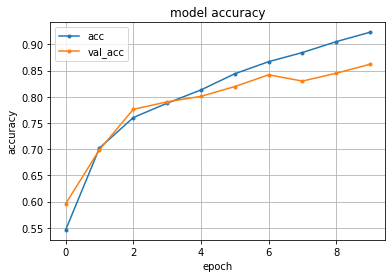

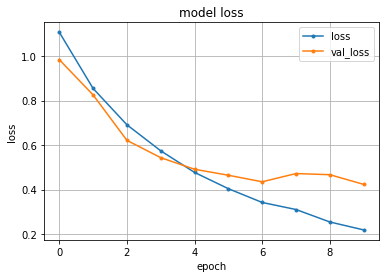

In [0]:
# 精度のplot
plt.plot(history.history['accuracy'], marker='.', label='acc')
plt.plot(history.history['val_accuracy'], marker='.', label='val_acc')
plt.title('model accuracy')
plt.grid()
plt.xlabel('epoch')
plt.ylabel('accuracy')
plt.legend(loc='best')
plt.show()

# 損失のplot
plt.plot(history.history['loss'], marker='.', label='loss')
plt.plot(history.history['val_loss'], marker='.', label='val_loss')
plt.title('model loss')
plt.grid()
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(loc='best')
plt.show()

# 83

In [0]:
model = RNN81(len(vocab_dict), 300, 50, 4)
model.compile(optimizer=tf.keras.optimizers.SGD(learning_rate=0.1),
              loss=loss,
              metrics=['accuracy']
             )
model.build(train_s.shape)
model.summary()

Model: "rn_n81_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_1 (Embedding)      multiple                  2910300   
_________________________________________________________________
lstm_1 (LSTM)                multiple                  70200     
_________________________________________________________________
dense_1 (Dense)              multiple                  204       
Total params: 2,980,704
Trainable params: 2,980,704
Non-trainable params: 0
_________________________________________________________________


In [0]:
!rm -r '/content/drive/My Drive/Colab/NLP100/log/83'

In [0]:
tb_cb = tf.keras.callbacks.TensorBoard(
    log_dir='/content/drive/My Drive/Colab/NLP100/log/83',
    histogram_freq=1,
    write_images=True
)

In [0]:
%reload_ext tensorboard
%tensorboard --logdir '/content/drive/My Drive/Colab/NLP100/log/83' --bind_all  --reload_multifile true

Output hidden; open in https://colab.research.google.com to view.

In [0]:
history = model.fit(train_s,train_t,
                    epochs=10, 
                    validation_data=(valid_s, valid_t),
                    verbose=1,
                    callbacks=[tb_cb],
                    batch_size=1024
                   )

Train on 10684 samples, validate on 1336 samples
Epoch 1/10
10684/10684 [==============================] - 5s 503us/sample - loss: 1.3025 - accuracy: 0.4629 - val_loss: 1.2316 - val_accuracy: 0.5397
Epoch 2/10
10684/10684 [==============================] - 1s 138us/sample - loss: 1.2013 - accuracy: 0.5377 - val_loss: 1.1787 - val_accuracy: 0.5516
Epoch 3/10
10684/10684 [==============================] - 2s 141us/sample - loss: 1.1653 - accuracy: 0.5585 - val_loss: 1.1605 - val_accuracy: 0.5524
Epoch 4/10
10684/10684 [==============================] - 2s 140us/sample - loss: 1.1523 - accuracy: 0.5651 - val_loss: 1.1532 - val_accuracy: 0.5352
Epoch 5/10
10684/10684 [==============================] - 2s 142us/sample - loss: 1.1461 - accuracy: 0.5535 - val_loss: 1.1476 - val_accuracy: 0.5711
Epoch 6/10
10684/10684 [==============================] - 2s 142us/sample - loss: 1.1422 - accuracy: 0.5726 - val_loss: 1.1450 - val_accuracy: 0.5404
Epoch 7/10
10684/10684 [===========================

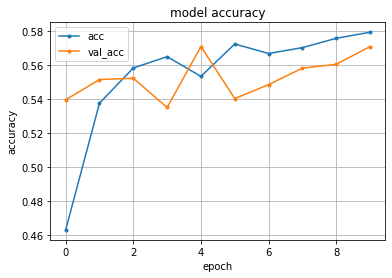

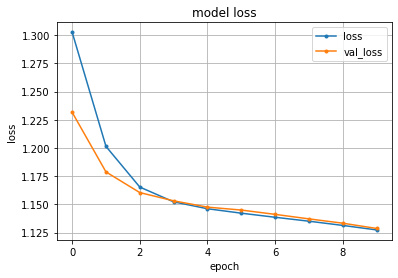

In [0]:
# 精度のplot
plt.plot(history.history['accuracy'], marker='.', label='acc')
plt.plot(history.history['val_accuracy'], marker='.', label='val_acc')
plt.title('model accuracy')
plt.grid()
plt.xlabel('epoch')
plt.ylabel('accuracy')
plt.legend(loc='best')
plt.show()

# 損失のplot
plt.plot(history.history['loss'], marker='.', label='loss')
plt.plot(history.history['val_loss'], marker='.', label='val_loss')
plt.title('model loss')
plt.grid()
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(loc='best')
plt.show()

# 84

In [0]:
from gensim.models import KeyedVectors
vectors = KeyedVectors.load('/content/drive/My Drive/Colab/NLP100/data/GoogleNews-vectors-negative300.kv', mmap='r')

/usr/local/lib/python3.6/dist-packages/smart_open/smart_open_lib.py:253: UserWarning:

This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function



In [0]:
model = RNN81(len(vocab_dict), 300, 50, 4)
model.compile(optimizer=tf.keras.optimizers.SGD(learning_rate=0.1),
              loss=loss,
              metrics=['accuracy']
             )
model.build(train_s.shape)
model.summary()

Model: "rn_n81_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_2 (Embedding)      multiple                  2910300   
_________________________________________________________________
lstm_2 (LSTM)                multiple                  70200     
_________________________________________________________________
dense_2 (Dense)              multiple                  204       
Total params: 2,980,704
Trainable params: 2,980,704
Non-trainable params: 0
_________________________________________________________________


In [0]:
print('学習データでの正解率 :', acc(train_t, model(train_s)).numpy())
print('評価データでの正解率 :', acc(test_t, model(test_s)).numpy())

学習データでの正解率 : 0.24672407
評価データでの正解率 : 0.23652695


In [0]:
model.emb.weights[0].numpy()[7]

array([ 4.76792119e-02, -4.22781482e-02, -4.92846966e-03, -3.11762448e-02,
        1.53976418e-02, -2.74607185e-02, -4.49748151e-02, -4.37126309e-03,
        2.81184800e-02,  3.41439135e-02,  2.32623890e-03, -4.56139222e-02,
        4.36199792e-02,  3.39424945e-02,  3.04023139e-02,  2.69696154e-02,
       -3.52239609e-02, -1.90599915e-02, -2.63374802e-02, -2.23445650e-02,
       -5.50352037e-04, -4.41722386e-02, -1.47392265e-02,  3.27068083e-02,
       -3.20833102e-02,  3.22164632e-02,  8.03416967e-03, -3.94097455e-02,
       -2.35844981e-02, -4.30431962e-02,  2.39372514e-02,  2.13570036e-02,
       -4.96508740e-02, -1.15397573e-02,  2.63898447e-03,  2.92437561e-02,
       -1.34270787e-02, -2.57618353e-03,  1.30141862e-02,  4.73758467e-02,
       -4.97616641e-02, -4.38260920e-02,  2.97071598e-02, -1.52316466e-02,
       -3.80189791e-02, -1.86220780e-02, -2.81371363e-02,  4.16930802e-02,
       -4.49281000e-02,  1.93929188e-02,  1.49532221e-02,  1.59469955e-02,
        2.35778727e-02, -

In [0]:
tf.constant(vectors['in']).numpy()

array([ 0.0703125 ,  0.08691406,  0.08789062,  0.0625    ,  0.06933594,
       -0.10888672, -0.08154297, -0.15429688,  0.02075195,  0.13183594,
       -0.11376953, -0.03735352,  0.06933594,  0.078125  , -0.10302734,
       -0.09765625,  0.04418945,  0.10253906, -0.06079102, -0.03613281,
       -0.04541016,  0.04736328, -0.12060547, -0.06396484,  0.0022583 ,
        0.03710938, -0.00291443,  0.11767578,  0.06176758,  0.06396484,
        0.08105469, -0.06884766, -0.0213623 ,  0.05517578, -0.08544922,
        0.06884766, -0.12792969, -0.03320312,  0.09863281,  0.17578125,
        0.11083984, -0.03466797, -0.04711914, -0.00848389,  0.03588867,
        0.10302734,  0.02697754, -0.02868652, -0.00512695,  0.10644531,
        0.05981445,  0.09423828,  0.03369141, -0.02709961, -0.09423828,
        0.00102997, -0.04833984,  0.03442383,  0.08105469, -0.11328125,
       -0.08886719,  0.03588867, -0.14550781, -0.24414062, -0.06152344,
        0.05297852,  0.05688477,  0.1796875 ,  0.06103516,  0.08

In [0]:
for i, token in enumerate(vocab_dict):
    if token in vectors:
        model.emb.weights[0][i].assign(tf.constant(vectors[token]))

In [0]:
print('学習データでの正解率 :', acc(train_t, model(train_s)).numpy())
print('評価データでの正解率 :', acc(test_t, model(test_s)).numpy())

学習データでの正解率 : 0.35913515
評価データでの正解率 : 0.36601797


In [0]:
!rm -r '/content/drive/My Drive/Colab/NLP100/log/84'

tb_cb = tf.keras.callbacks.TensorBoard(
    log_dir='/content/drive/My Drive/Colab/NLP100/log/84',
    histogram_freq=1,
    write_images=True
)

%reload_ext tensorboard
%tensorboard --logdir '/content/drive/My Drive/Colab/NLP100/log/84' --bind_all --reload_multifile true

Output hidden; open in https://colab.research.google.com to view.

In [0]:
history = model.fit(train_s,train_t,
                    epochs=100, 
                    validation_data=(valid_s, valid_t),
                    verbose=1,
                    callbacks=[tb_cb],
                    batch_size=1024
                   )

Train on 10684 samples, validate on 1336 samples
Epoch 1/100
10684/10684 [==============================] - 6s 520us/sample - loss: 1.2484 - accuracy: 0.5662 - val_loss: 1.1490 - val_accuracy: 0.6819
Epoch 2/100
10684/10684 [==============================] - 1s 139us/sample - loss: 1.0981 - accuracy: 0.7147 - val_loss: 1.0498 - val_accuracy: 0.7493
Epoch 3/100
10684/10684 [==============================] - 1s 140us/sample - loss: 1.0028 - accuracy: 0.7583 - val_loss: 0.9501 - val_accuracy: 0.7650
Epoch 4/100
10684/10684 [==============================] - 2s 147us/sample - loss: 0.8863 - accuracy: 0.7698 - val_loss: 0.8135 - val_accuracy: 0.7732
Epoch 5/100
10684/10684 [==============================] - 1s 140us/sample - loss: 0.7486 - accuracy: 0.7776 - val_loss: 0.6980 - val_accuracy: 0.7762
Epoch 6/100
10684/10684 [==============================] - 2s 144us/sample - loss: 0.6600 - accuracy: 0.7817 - val_loss: 0.6447 - val_accuracy: 0.7747
Epoch 7/100
10684/10684 [====================

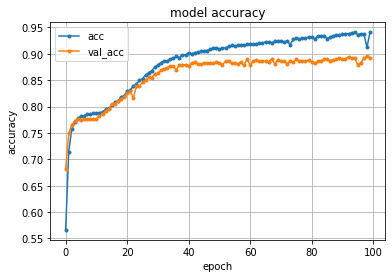

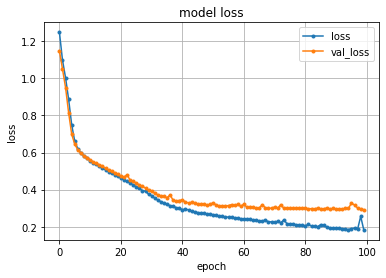

In [0]:
# 精度のplot
plt.plot(history.history['accuracy'], marker='.', label='acc')
plt.plot(history.history['val_accuracy'], marker='.', label='val_acc')
plt.title('model accuracy')
plt.grid()
plt.xlabel('epoch')
plt.ylabel('accuracy')
plt.legend(loc='best')
plt.show()

# 損失のplot
plt.plot(history.history['loss'], marker='.', label='loss')
plt.plot(history.history['val_loss'], marker='.', label='val_loss')
plt.title('model loss')
plt.grid()
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(loc='best')
plt.show()

In [0]:
print('学習データでの正解率 :', acc(train_t, model(train_s)).numpy())
print('評価データでの正解率 :', acc(test_t, model(test_s)).numpy())

学習データでの正解率 : 0.94281167
評価データでの正解率 : 0.91092813


# 85

In [0]:
model = tf.keras.Sequential()

model.add(tf.keras.layers.Embedding(
            input_dim=len(vocab_dict), 
            output_dim=300,
            mask_zero=True,
            input_length=max_len,
            name="emb"))
model.add(tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(64, return_sequences=True)))
model.add(tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(32)))
model.add(tf.keras.layers.Dense(4, activation='softmax'))

model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
emb (Embedding)              (None, 25, 300)           2910300   
_________________________________________________________________
bidirectional (Bidirectional (None, 25, 128)           186880    
_________________________________________________________________
bidirectional_1 (Bidirection (None, 64)                41216     
_________________________________________________________________
dense_3 (Dense)              (None, 4)                 260       
Total params: 3,138,656
Trainable params: 3,138,656
Non-trainable params: 0
_________________________________________________________________


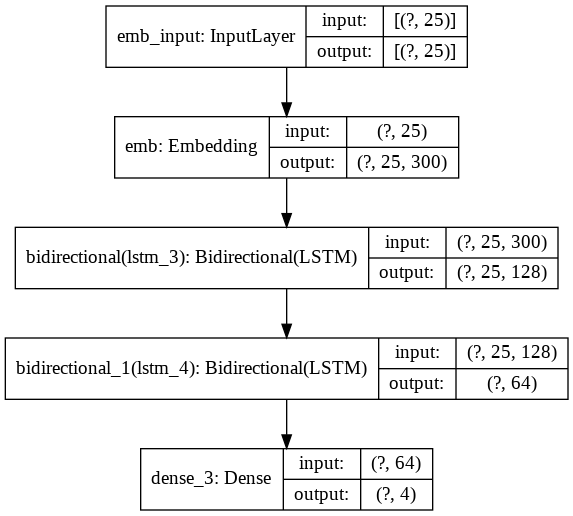

In [0]:
tf.keras.utils.plot_model(model,show_shapes=True)

In [0]:
model.compile(optimizer=tf.keras.optimizers.SGD(learning_rate=0.1),
              loss=loss,
              metrics=['accuracy']
             )

In [0]:
print('学習データでの正解率 :', acc(train_t, model(train_s)).numpy())
print('評価データでの正解率 :', acc(test_t, model(test_s)).numpy())

学習データでの正解率 : 0.23062523
評価データでの正解率 : 0.26197603


In [0]:
for i, token in enumerate(vocab_dict):
    if token in vectors:
        model.get_layer("emb").weights[0][i].assign(tf.constant(vectors[token]))

In [0]:
print('学習データでの正解率 :', acc(train_t, model(train_s)).numpy())
print('評価データでの正解率 :', acc(test_t, model(test_s)).numpy())

学習データでの正解率 : 0.31514415
評価データでの正解率 : 0.31362274


In [0]:
!rm -r '/content/drive/My Drive/Colab/NLP100/log/85'

In [0]:
tb_cb = tf.keras.callbacks.TensorBoard(
    log_dir='/content/drive/My Drive/Colab/NLP100/log/85',
    histogram_freq=1,
    write_images=True
)

In [0]:
%reload_ext tensorboard
%tensorboard --logdir '/content/drive/My Drive/Colab/NLP100/log/85'  --bind_all --reload_multifile true

Output hidden; open in https://colab.research.google.com to view.

In [0]:
history = model.fit(train_s,train_t,
                    epochs=100, 
                    validation_data=(valid_s, valid_t),
                    verbose=1,
                    callbacks=[tb_cb],
                    batch_size=1024
                   )

Train on 10684 samples, validate on 1336 samples
Epoch 1/100
10684/10684 [==============================] - 19s 2ms/sample - loss: 1.2384 - accuracy: 0.5914 - val_loss: 1.1405 - val_accuracy: 0.7066
Epoch 2/100
10684/10684 [==============================] - 3s 316us/sample - loss: 1.0996 - accuracy: 0.7308 - val_loss: 1.0598 - val_accuracy: 0.7597
Epoch 3/100
10684/10684 [==============================] - 3s 317us/sample - loss: 1.0187 - accuracy: 0.7588 - val_loss: 0.9673 - val_accuracy: 0.7560
Epoch 4/100
10684/10684 [==============================] - 3s 309us/sample - loss: 0.9116 - accuracy: 0.7661 - val_loss: 0.8456 - val_accuracy: 0.7732
Epoch 5/100
10684/10684 [==============================] - 3s 312us/sample - loss: 0.7886 - accuracy: 0.7717 - val_loss: 0.7406 - val_accuracy: 0.7747
Epoch 6/100
10684/10684 [==============================] - 3s 318us/sample - loss: 0.7004 - accuracy: 0.7755 - val_loss: 0.6765 - val_accuracy: 0.7784
Epoch 7/100
10684/10684 [=====================

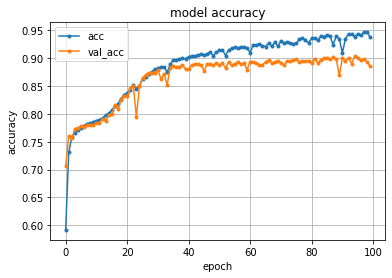

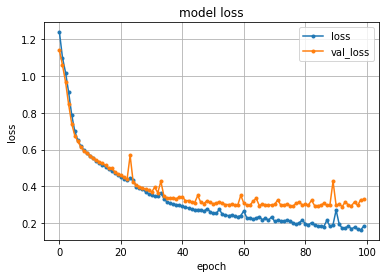

In [0]:
# 精度のplot
plt.plot(history.history['accuracy'], marker='.', label='acc')
plt.plot(history.history['val_accuracy'], marker='.', label='val_acc')
plt.title('model accuracy')
plt.grid()
plt.xlabel('epoch')
plt.ylabel('accuracy')
plt.legend(loc='best')
plt.show()

# 損失のplot
plt.plot(history.history['loss'], marker='.', label='loss')
plt.plot(history.history['val_loss'], marker='.', label='val_loss')
plt.title('model loss')
plt.grid()
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(loc='best')
plt.show()

# 86

In [0]:
class CNN86(tf.keras.Model):
    def __init__(self, v_size, e_size, h_size, c_size, kernel_size=3, dropout=0.2):
        super().__init__()
        self.c_size = c_size
        self.emb = tf.keras.layers.Embedding(input_dim=v_size, 
                                             output_dim=e_size,
                                             mask_zero=True,
                                             input_length=max_len,
                                             name="emb"
                                            )
        self.dropout_1 = tf.keras.layers.Dropout(dropout)
        self.conv = tf.keras.layers.Conv1D(h_size,
                                           kernel_size,
                                           padding="causal",
                                           data_format='channels_last',
                                          )
        self.relu = tf.keras.layers.ReLU()
        self.maxpooling = tf.keras.layers.MaxPooling1D(pool_size=max_len, data_format='channels_last',)
        self.dropout_2 = tf.keras.layers.Dropout(dropout)
        self.out = tf.keras.layers.Dense(c_size)
    def call(self, x):
        x = self.emb(x)
        x = self.dropout_1(x)
        x = self.conv(x)
        x = self.relu(x)
        x = self.maxpooling(x)
        x = self.dropout_2(x)
        x = tf.nn.softmax(self.out(x))
        y = tf.reshape(x, (-1, self.c_size))
        return y

In [0]:
model = CNN86(len(vocab_dict), 300, 128, 4, kernel_size=3, dropout=0.5)
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
              loss=loss,
              metrics=['accuracy']
             )
model.build(test_s.shape)
model.summary()

Model: "cn_n86"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
emb (Embedding)              multiple                  2910300   
_________________________________________________________________
dropout (Dropout)            multiple                  0         
_________________________________________________________________
conv1d (Conv1D)              multiple                  115328    
_________________________________________________________________
re_lu (ReLU)                 multiple                  0         
_________________________________________________________________
max_pooling1d (MaxPooling1D) multiple                  0         
_________________________________________________________________
dropout_1 (Dropout)          multiple                  0         
_________________________________________________________________
dense_4 (Dense)              multiple                  516  

In [0]:
print('学習データでの正解率 :', acc(train_t, model(train_s)).numpy())
print('評価データでの正解率 :', acc(test_t, model(test_s)).numpy())

学習データでの正解率 : 0.187383
評価データでの正解率 : 0.16616766


# 87

In [0]:
for i, token in enumerate(vocab_dict):
    if token in vectors:
        model.get_layer("emb").weights[0][i].assign(tf.constant(vectors[token]))

In [0]:
print('学習データでの正解率 :', acc(train_t, model(train_s)).numpy())
print('評価データでの正解率 :', acc(test_t, model(test_s)).numpy())

学習データでの正解率 : 0.23090602
評価データでの正解率 : 0.21556886


In [0]:
!rm -r '/content/drive/My Drive/Colab/NLP100/log/87'

In [0]:
tb_cb = tf.keras.callbacks.TensorBoard(
    log_dir='/content/drive/My Drive/Colab/NLP100/log/87',
    histogram_freq=1,
    write_images=True
)

In [0]:
%reload_ext tensorboard
%tensorboard --logdir '/content/drive/My Drive/Colab/NLP100/log/87' --bind_all --reload_multifile true

Output hidden; open in https://colab.research.google.com to view.

In [0]:
history = model.fit(train_s,train_t,
                    epochs=50, 
                    validation_data=(valid_s, valid_t),
                    verbose=1,
                    callbacks=[tb_cb],
                    batch_size=1024
                   )

Train on 10684 samples, validate on 1336 samples
Epoch 1/50
10684/10684 [==============================] - 3s 321us/sample - loss: 1.1108 - accuracy: 0.5534 - val_loss: 0.7283 - val_accuracy: 0.7575
Epoch 2/50
10684/10684 [==============================] - 2s 171us/sample - loss: 0.7424 - accuracy: 0.7498 - val_loss: 0.5556 - val_accuracy: 0.8001
Epoch 3/50
10684/10684 [==============================] - 2s 166us/sample - loss: 0.5728 - accuracy: 0.7978 - val_loss: 0.4489 - val_accuracy: 0.8488
Epoch 4/50
10684/10684 [==============================] - 2s 164us/sample - loss: 0.4670 - accuracy: 0.8392 - val_loss: 0.3816 - val_accuracy: 0.8728
Epoch 5/50
10684/10684 [==============================] - 2s 163us/sample - loss: 0.3989 - accuracy: 0.8609 - val_loss: 0.3361 - val_accuracy: 0.8892
Epoch 6/50
10684/10684 [==============================] - 2s 165us/sample - loss: 0.3389 - accuracy: 0.8832 - val_loss: 0.3037 - val_accuracy: 0.8922
Epoch 7/50
10684/10684 [===========================

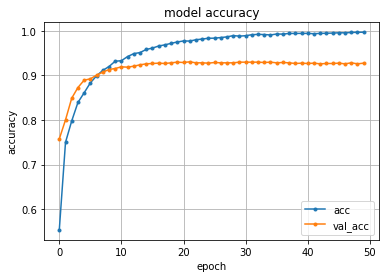

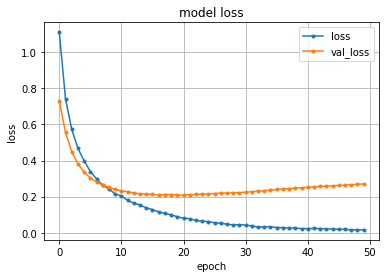

In [0]:
# 精度のplot
plt.plot(history.history['accuracy'], marker='.', label='acc')
plt.plot(history.history['val_accuracy'], marker='.', label='val_acc')
plt.title('model accuracy')
plt.grid()
plt.xlabel('epoch')
plt.ylabel('accuracy')
plt.legend(loc='best')
plt.show()

# 損失のplot
plt.plot(history.history['loss'], marker='.', label='loss')
plt.plot(history.history['val_loss'], marker='.', label='val_loss')
plt.title('model loss')
plt.grid()
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(loc='best')
plt.show()

# 88

In [0]:
tf.keras.backend.clear_session()
!rm -r '/content/drive/My Drive/Colab/NLP100/log/88'
%reload_ext tensorboard
%tensorboard --logdir '/content/drive/My Drive/Colab/NLP100/log/88' --bind_all --reload_multifile true

Output hidden; open in https://colab.research.google.com to view.

In [0]:
class CNN88(tf.keras.Model):
    def __init__(self, v_size, e_size, h_size, c_size, padding, activation, dropout_1, dropout_2,kernel_size=3):
        super().__init__()
        self.c_size = c_size
        self.emb = tf.keras.layers.Embedding(input_dim=v_size, 
                                             output_dim=e_size,
                                             mask_zero=True,
                                             input_length=max_len,
                                             name="emb"
                                            )
        self.dropout_1 = tf.keras.layers.Dropout(dropout_1)
        self.conv = tf.keras.layers.Conv1D(h_size,
                                           kernel_size,
                                           padding=padding,
                                           data_format='channels_last',
                                           activation=activation,
                                           name="conv1d"
                                          )
        self.maxpooling = tf.keras.layers.MaxPooling1D(pool_size=max_len, name="maxpool")
        self.dropout_2 = tf.keras.layers.Dropout(dropout_2)
        self.out = tf.keras.layers.Dense(c_size,
                                         activation='softmax'
                                        )
    def call(self, x):
        x = self.emb(x)
        x = self.dropout_1(x)
        x = self.conv(x)
        x = self.maxpooling(x)
        x = self.dropout_2(x)
        x = self.out(x)
        y = tf.reshape(x, (-1, self.c_size))
        return y

In [0]:
def objective(trial):
    # 調整したいハイパーパラメータの設定
    padding = trial.suggest_categorical('padding', ['same', 'causal'])
    h_size = trial.suggest_int('h_size', 10, 300) # ユニット数
    dropout_1 = trial.suggest_uniform('dropout_1', 0, 1) # ドロップアウト率
    dropout_2 = trial.suggest_uniform('dropout_2', 0, 1) # ドロップアウト率
    activation = trial.suggest_categorical('activation', ['relu','sigmoid','tanh']) # 活性化関数
    learning_index = trial.suggest_uniform('learning_index', -3, 2) 
    learning_rate = 10**learning_index
    batch_size = 1024
    
    log_dir = '/content/drive/My Drive/Colab/NLP100/log/88/' + 'model_' + "_".join(map(str,[padding, h_size, dropout_1, dropout_2, activation, learning_rate, batch_size]))
    tb_cb = tf.keras.callbacks.TensorBoard(
        log_dir=log_dir,
        histogram_freq=0,
        write_images=True,
    )
    
    tf.keras.backend.clear_session()
    
    # 学習モデルの構築と学習の開始
    model = CNN88(len(vocab_dict), 300, h_size, 4, padding, activation, dropout_1, dropout_2)
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
                    loss=loss,
                    metrics=['accuracy'])
    history = model.fit(train_s, train_t, 
                        verbose=0,
                        epochs=50,
                        validation_data=(valid_s, valid_t),
                        callbacks=[tb_cb],
                        batch_size=batch_size)

    # 最小値探索なので
    return -np.amax(history.history['val_accuracy'])

In [0]:
study = optuna.create_study(sampler=optuna.samplers.TPESampler())
study.optimize(objective, show_progress_bar=True)

/usr/local/lib/python3.6/dist-packages/optuna/_experimental.py:90: ExperimentalWarning:

Progress bar is experimental (supported from v1.2.0). The interface can change in the future.



[I 2020-04-30 15:05:18,166] Finished trial#0 with value: -0.405688613653183 with parameters: {'padding': 'same', 'h_size': 169, 'dropout_1': 0.1792084557268273, 'dropout_2': 0.37676117701533507, 'activation': 'tanh', 'learning_index': 1.96967756371198}. Best is trial#0 with value: -0.405688613653183.
[I 2020-04-30 15:06:27,769] Finished trial#1 with value: -0.8405688405036926 with parameters: {'padding': 'causal', 'h_size': 183, 'dropout_1': 0.15669689278860044, 'dropout_2': 0.7166747112747058, 'activation': 'sigmoid', 'learning_index': -1.0494584081445242}. Best is trial#1 with value: -0.8405688405036926.
[I 2020-04-30 15:07:35,757] Finished trial#2 with value: -0.405688613653183 with parameters: {'padding': 'same', 'h_size': 170, 'dropout_1': 0.5492090969514524, 'dropout_2': 0.15448087261507715, 'activation': 'relu', 'learning_index': 0.0766498497741579}. Best is trial#1 with value: -0.8405688405036926.
[I 2020-04-30 15:08:48,640] Finished trial#3 with value: -0.40643712878227234 wit

KeyboardInterrupt: ignored

In [0]:
print('best_params')
print(study.best_params)
print('-1 x best_value')
print(-study.best_value)

best_params
{'padding': 'same', 'h_size': 300, 'dropout_1': 0.8195767926074818, 'dropout_2': 0.07102513075101183, 'activation': 'sigmoid', 'learning_index': -2.80528482300857}
-1 x best_value
0.9206587076187134


# 89. 事前学習済み言語モデルからの転移学習

In [0]:
from transformers import *

In [24]:
tokenizer = BertTokenizer.from_pretrained('bert-base-cased')

In [25]:
len(tokenizer.get_vocab())

28996

In [0]:
categories = ['b', 't', 'e', 'm']
category_names = ['business', 'science and technology', 'entertainment', 'health']

In [0]:
def read_for_bert(filename):
    with open(filename) as f:
        dataset = f.read().splitlines()
    dataset = [line.split('\t') for line in dataset]
    t_index = [categories.index(line[0]) for line in dataset]
    dataset_t = []
    for index in t_index:
        label = [0]*4
        label[index] = 1
        dataset_t.append(tf.constant(label))
    dataset_x = [tf.constant(tokenizer.encode(line[1]), dtype=tf.int32) for line in dataset]
    return dataset_x, dataset_t

bert_train_x, bert_train_t = read_for_bert('/content/drive/My Drive/Colab/NLP100/data/train.txt')
bert_valid_x, bert_valid_t = read_for_bert('/content/drive/My Drive/Colab/NLP100/data/valid.txt')
bert_test_x, bert_test_t = read_for_bert('/content/drive/My Drive/Colab/NLP100/data/test.txt')

In [28]:
max_len = 0
for x in bert_train_x:
    if x.shape[0] > max_len:
        max_len = x.shape[0]
for x in bert_valid_x:
    if x.shape[0] > max_len:
        max_len = x.shape[0]
max_len

40

In [0]:
def padding_zero(data, max_len):
    ret = []
    for i in range(len(data)):
        zero = [0] * (max_len - data[i].shape[0])
        ret.append(tf.concat([data[i], zero], 0))
    return tf.stack(ret)

In [0]:
bert_train_x = padding_zero(bert_train_x, max_len)
bert_train_t = tf.stack(bert_train_t)
bert_valid_x = padding_zero(bert_valid_x, max_len)
bert_valid_t = tf.stack(bert_valid_t)
bert_test_x = padding_zero(bert_test_x, max_len)
bert_test_t = tf.stack(bert_test_t)

In [0]:
tf.keras.backend.clear_session()

In [88]:
input_ids = tf.keras.Input(shape=(max_len, ), dtype='int32', name='input_ids')
inputs = input_ids

mask = tf.keras.layers.Masking(mask_value=0)

bert = TFBertModel.from_pretrained('bert-base-cased')
bert.layers[0].trainable = False

x = mask(inputs)
out = bert.layers[0](x)
out = out[1]
out = tf.keras.layers.Dropout(0.2)(out)
out = tf.keras.layers.Dense(128, activation='relu')(out)
out = tf.keras.layers.Dropout(0.5)(out)
out = tf.keras.layers.Dense(4, activation='softmax')(out)
model = tf.keras.Model(inputs=inputs, outputs=out)
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_ids (InputLayer)       [(None, 40)]              0         
_________________________________________________________________
masking (Masking)            (None, 40)                0         
_________________________________________________________________
bert (TFBertMainLayer)       ((None, 40, 768), (None,  108310272 
_________________________________________________________________
dropout_37 (Dropout)         (None, 768)               0         
_________________________________________________________________
dense (Dense)                (None, 128)               98432     
_________________________________________________________________
dropout_38 (Dropout)         (None, 128)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 4)                 516   

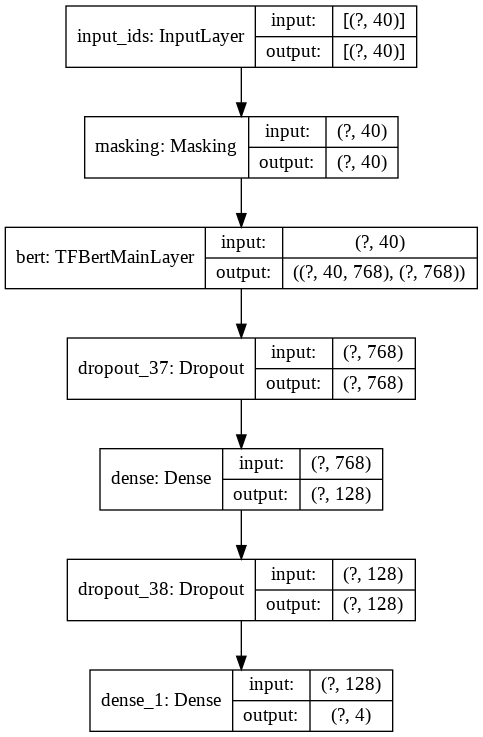

In [89]:
tf.keras.utils.plot_model(model, show_shapes=True, show_layer_names=True, expand_nested=True)

In [0]:
!rm -r '/content/drive/My Drive/Colab/NLP100/log/89'

In [0]:
tb_cb = tf.keras.callbacks.TensorBoard(
    log_dir='/content/drive/My Drive/Colab/NLP100/log/89',
    histogram_freq=1,
    write_images=True
)

In [86]:
%reload_ext tensorboard
%tensorboard --logdir '/content/drive/My Drive/Colab/NLP100/log/89' --bind_all --reload_multifile true

Output hidden; open in https://colab.research.google.com to view.

In [92]:
model.compile(optimizer=tf.keras.optimizers.SGD(learning_rate=0.1),
              loss=loss,
              metrics=['accuracy']
             )
history = model.fit(bert_train_x, bert_train_t,
                    epochs=100, 
                    validation_data=(bert_valid_x, bert_valid_t),
                    verbose=1,
                    batch_size=1024,
                    callbacks=[tb_cb]
                   )

Train on 10684 samples, validate on 1336 samples
Epoch 1/100
10684/10684 [==============================] - 68s 6ms/sample - loss: 2.0439 - accuracy: 0.3707 - val_loss: 1.1600 - val_accuracy: 0.4177
Epoch 2/100
10684/10684 [==============================] - 56s 5ms/sample - loss: 1.1814 - accuracy: 0.4569 - val_loss: 1.1310 - val_accuracy: 0.5704
Epoch 3/100
10684/10684 [==============================] - 56s 5ms/sample - loss: 1.1729 - accuracy: 0.4629 - val_loss: 1.1469 - val_accuracy: 0.5771
Epoch 4/100
10684/10684 [==============================] - 56s 5ms/sample - loss: 1.1638 - accuracy: 0.4768 - val_loss: 1.1096 - val_accuracy: 0.5763
Epoch 5/100
10684/10684 [==============================] - 57s 5ms/sample - loss: 1.1621 - accuracy: 0.4748 - val_loss: 1.1235 - val_accuracy: 0.5404
Epoch 6/100
10684/10684 [==============================] - 56s 5ms/sample - loss: 1.1583 - accuracy: 0.4773 - val_loss: 1.1255 - val_accuracy: 0.5240
Epoch 7/100
10684/10684 [==========================

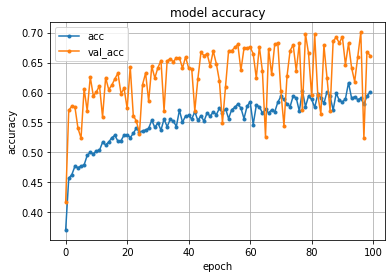

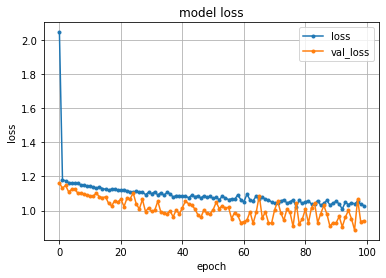

In [93]:
# 精度のplot
plt.plot(history.history['accuracy'], marker='.', label='acc')
plt.plot(history.history['val_accuracy'], marker='.', label='val_acc')
plt.title('model accuracy')
plt.grid()
plt.xlabel('epoch')
plt.ylabel('accuracy')
plt.legend(loc='best')
plt.show()

# 損失のplot
plt.plot(history.history['loss'], marker='.', label='loss')
plt.plot(history.history['val_loss'], marker='.', label='val_loss')
plt.title('model loss')
plt.grid()
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(loc='best')
plt.show()

In [99]:
#print('学習データでの正解率 :', acc(bert_train_t, model(bert_train_x)).numpy())
print('評価データでの正解率 :', acc(bert_test_t[:300], model(bert_test_x[:300])).numpy())

評価データでの正解率 : 0.65
